In [2]:
# to install the correct version of pytorch for this CUDA device:
# conda install pytorch torchvision torchaudio cudatoolkit=11.1 -c pytorch -c nvidia
#
# scvi-tools was installed using the conda instructions on the scvi website
# scanpy was installed using the conda instructions on the scanpy website

import scvi
import torch
import scanpy as sc
import anndata
from scipy import io
from scipy.sparse import coo_matrix, csr_matrix
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
import os
import pandas as pd
#import skmisc

sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
torch.cuda.is_available()

True

In [6]:
anndata.__version__

'0.8.0'

In [3]:
data_dir = 'scvi/data/'
fig_dir = 'scvi/figures/'

In [3]:
# re-load processed dataset:
adata = sc.read_h5ad('{}ADDS_integrated_adata_filtered_11-12-21.h5ad'.format(data_dir))

In [4]:
def get_cluster_proportions(adata,
                            cluster_key="cluster_final",
                            sample_key="replicate",
                            drop_values=None):
    """
    Input
    =====
    adata : AnnData object
    cluster_key : key of `adata.obs` storing cluster info
    sample_key : key of `adata.obs` storing sample/replicate info
    drop_values : list/iterable of possible values of `sample_key` that you don't want
    
    Returns
    =======
    pd.DataFrame with samples as the index and clusters as the columns and 0-100 floats
    as values
    """
    
    adata_tmp = adata.copy()
    sizes = adata_tmp.obs.groupby([cluster_key, sample_key]).size()
    props = sizes.groupby(level=1).apply(lambda x: 100 * x / x.sum()).reset_index() 
    props = props.pivot(columns=sample_key, index=cluster_key).T
    props.index = props.index.droplevel(0)
    props.fillna(0, inplace=True)
    
    if drop_values is not None:
        for drop_value in drop_values:
            props.drop(drop_value, axis=0, inplace=True)
    return props


def plot_cluster_proportions(cluster_props, 
                             cluster_palette=None,
                             xlabel_rotation=0): 
    fig, ax = plt.subplots(dpi=300)
    fig.patch.set_facecolor("white")
    
    cmap = None
    if cluster_palette is not None:
        cmap = sns.palettes.blend_palette(
            cluster_palette, 
            n_colors=len(cluster_palette), 
            as_cmap=True)
   
    cluster_props.plot(
        kind="bar", 
        stacked=True, 
        ax=ax, 
        legend=None, 
        colormap=cmap
    )
    
    ax.legend(bbox_to_anchor=(1.01, 1), frameon=False, title="Cluster")
    sns.despine(fig, ax)
    ax.tick_params(axis="x", rotation=xlabel_rotation)
    ax.set_xlabel(cluster_props.index.name.capitalize())
    ax.set_ylabel("Proportion")
    fig.tight_layout()

In [4]:
# load anndata object that has been processed with cellbender + scrublet
adata = sc.read_h5ad('/dfs7/swaruplab/smorabit/analysis/ADDS_2021/doublet_detection/data/ADDS_cellbender_scrublet_unfiltered.h5ad')

# drop columns with spaces in the names:
adata.obs = adata.obs.drop(['RNA con (ng/ul)', 'Dissection.Group', 'Date of Dissection'], axis=1)

In [5]:
adata

AnnData object with n_obs × n_vars = 611999 × 29889
    obs: 'cell_barcode', 'species', 'rnd1_well', 'rnd2_well', 'rnd3_well', 'umi_count', 'umi_count_50dup', 'gene_count', 'Sublibrary', 'Batch', 'batch', 'n_counts', 'doublet_scores', 'doublets', 'SampleID', 'BrainBank', 'CaseYear', 'CaseNum', 'Age', 'Sex', 'PMI', 'APoE', 'DX', 'NPDx1', 'NPDx2', 'NPDx3', 'TangleStage', 'PlaqueStage', 'RIN', 'Region', 'Randomize'
    var: 'ensembl_id-0-0', 'gene_name'

## QC Filtering


In [7]:
adata.var['mt'] = adata.var_names.str.startswith('MT-') 
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

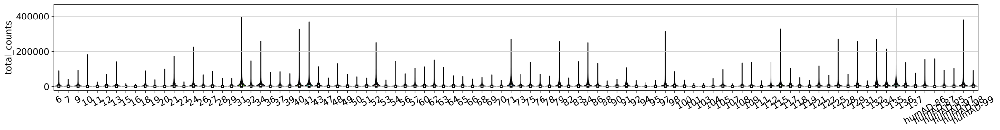

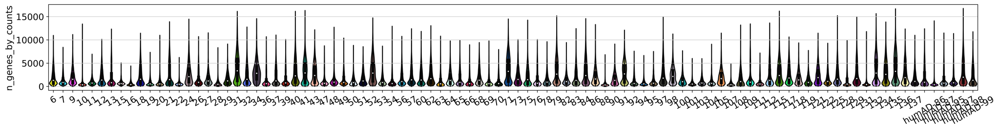

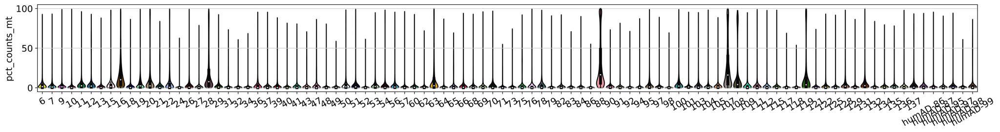

In [6]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,2.5), facecolor='white')
sc.pl.violin(adata,[ 'total_counts'], inner='box', size=0,  groupby='SampleID', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='SampleID', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='SampleID', multi_panel=False, rotation=30)

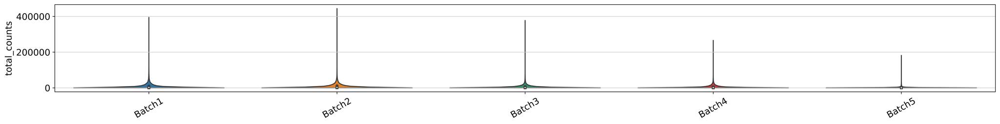

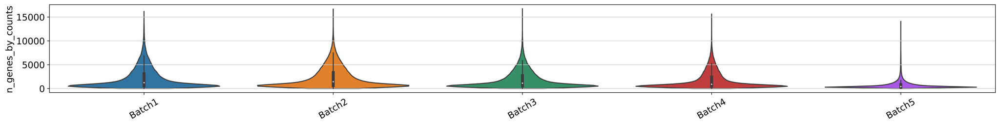

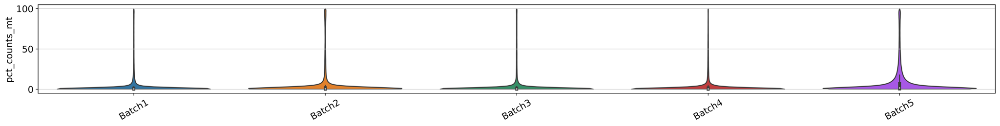

In [7]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,2.5), facecolor='white')
sc.pl.violin(adata,[ 'total_counts'], inner='box', size=0,  groupby='Batch', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='Batch', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='Batch', multi_panel=False, rotation=30)

In [8]:

mt_quantile = 0.95 
umi_quantile = 0.95
doublet_quantile = 0.95

samples = adata.obs.Batch.value_counts().index.to_list()
good_barcodes = []
for cur_sample in samples:
    
    # get just this sample
    cur_adata = adata[adata.obs.Batch == cur_sample]
    orig_cells = cur_adata.shape[0]
    
    # compute cutoffs for each sample
    mt_cutoff = cur_adata.obs.pct_counts_mt.quantile(mt_quantile)
    umi_cutoff = cur_adata.obs.total_counts.quantile(umi_quantile)
    doublet_cutoff = cur_adata.obs.doublet_scores.quantile(doublet_quantile)
    
    # subset the data based on thresholds
    cur_adata = cur_adata[(cur_adata.obs.pct_counts_mt < mt_cutoff) & (cur_adata.obs.total_counts < umi_cutoff) & (cur_adata.obs.doublet_scores < doublet_cutoff)]
    new_cells = cur_adata.shape[0]
    
    keep_cells = cur_adata.obs.cell_barcode.to_list() 
    good_barcodes = good_barcodes + keep_cells
    print(cur_sample, 'removed ', orig_cells-new_cells, ', kept ', new_cells)

    

Batch5 removed  29463 , kept  170353
Batch3 removed  15939 , kept  94956
Batch4 removed  15731 , kept  93270
Batch1 removed  14967 , kept  87590
Batch2 removed  13108 , kept  76622


In [9]:
# subset the full data by the good barcodes
adata = adata[adata.obs.cell_barcode.isin(good_barcodes)]
adata.shape

(585794, 29889)

In [10]:
# dataset-wide cutoffs

# remove cells with fewer than 250 UMI
adata = adata[adata.obs.total_counts >= 250]
adata = adata[adata.obs.pct_counts_mt <= 10]
adata = adata[adata.obs.total_counts <= 50000]
adata.shape

(510652, 29889)

In [11]:
# stricter cutoff for batch5:
batch5_obs = adata.obs[adata.obs.Batch == "Batch5"] 
batch5_obs = batch5_obs[batch5_obs.total_counts >= 500]
batch5_obs = batch5_obs[batch5_obs.pct_counts_mt <= 5]

adata = adata[(adata.obs.index.isin(batch5_obs.index)) | (adata.obs.Batch != 'Batch5')]
adata.shape

(431534, 29889)

## Data pre-processing

In [12]:
# pre-processing
sc.pp.filter_genes(adata, min_counts=3)
adata.layers["counts"] = adata.X.copy() # preserve counts
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata # freeze the state in `.raw`

Trying to set attribute `.var` of view, copying.


In [13]:
# feature selection
sc.pp.highly_variable_genes(
    adata,
    flavor="seurat_v3",
    n_top_genes=3500,
    layer="counts",
    batch_key="Batch",
    subset=True
)

In [18]:
# make sure the min count isn't 0 !!!!
np.asarray(adata.layers['counts'].sum(axis=1)).flatten().min()

11.0

## Train SCVI model

In [14]:
adata.shape

(431534, 3500)

In [15]:
# scvi setup
scvi.data.setup_anndata(
    adata,
    layer="counts",
    batch_key = 'Batch',
    categorical_covariate_keys=['SampleID', 'DX', 'Region'],
    continuous_covariate_keys=['pct_counts_mt', 'total_counts', 'Age', 'PMI', 'RIN']
    #continuous_covariate_keys=['pct_counts_mt', 'total_counts', 'Age']
 
)

INFO     Using batches from adata.obs["Batch"]                                               
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              


/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/sklearn/utils/deprecation.py:86: FutureWarning: Function setup_anndata is deprecated; Please use the model-specific setup_anndata methods instead. The global method will be removed in version 0.15.0.
  warnings.warn(msg, category=FutureWarning)


INFO     Successfully registered anndata object containing 431534 cells, 3500 vars, 5        
         batches, 1 labels, and 0 proteins. Also registered 3 extra categorical covariates   
         and 5 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          


In [16]:
# setup SCVI model
model = scvi.model.SCVI(
    adata,
    n_hidden = 128,
    n_latent = 30,
    n_layers = 2,
    dropout_rate = 0.1
)

In [21]:
model.train(batch_size=1024, max_epochs=50)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0,1,2,3]


Epoch 2/50:   2%|▏         | 1/50 [00:06<05:20,  6.54s/it, loss=974, v_num=1]

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/pytorch_lightning/trainer/trainer.py:897: UserWarning: Detected KeyboardInterrupt, attempting graceful shutdown...
  rank_zero_warn('Detected KeyboardInterrupt, attempting graceful shutdown...')


In [17]:
model.save("trained_model_11-12-21/", overwrite=True) 

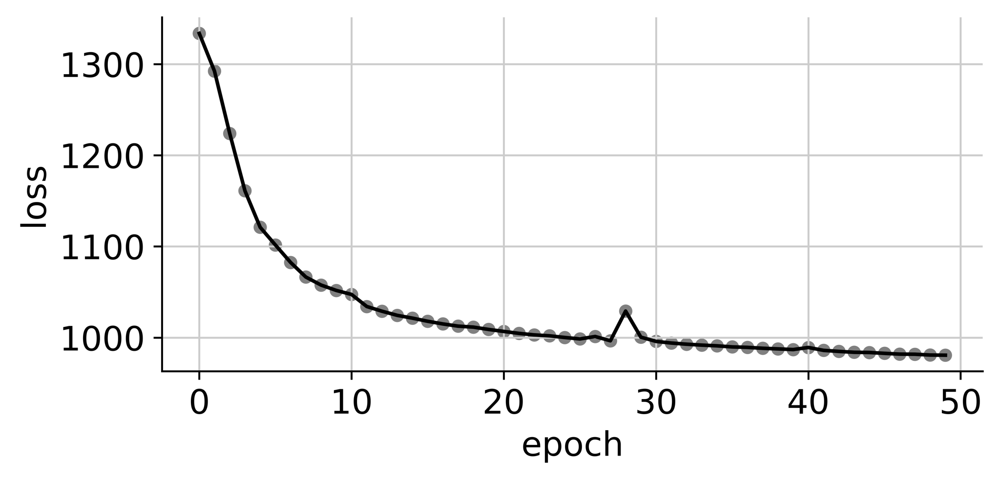

In [18]:

df = pd.DataFrame(model.history['elbo_train'])
df.columns = ['loss']
df['epoch'] = np.arange(0, df.shape[0])


fig, axes = plt.subplots(figsize=(6,3))
sns.scatterplot(data=df, x='epoch', y='loss', ax=axes, color='gray')
sns.lineplot(data=df, x='epoch', y='loss', ax=axes, color='black')

sns.despine();
plt.tight_layout()

In [19]:
# move latent representation to the adata object
latent = model.get_latent_representation()
adata.obsm["X_scVI"] = latent

# move normalized expression to adata object
adata.layers["scvi_normalized"] = model.get_normalized_expression(
    library_size=10e4
)

## Use scvi latent representation to perform UMAP + clustering

In [20]:
# use scVI latent space for UMAP generation
sc.pp.neighbors(adata, use_rep="X_scVI", metric='cosine', n_neighbors=10)
sc.tl.umap(adata, min_dist=0.2)

# add umap to obs table
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]


In [21]:
# run clustering with default settings
sc.tl.leiden(adata, resolution = 1.5)
sc.tl.dendrogram(adata, groupby="leiden", use_rep="X_scVI")

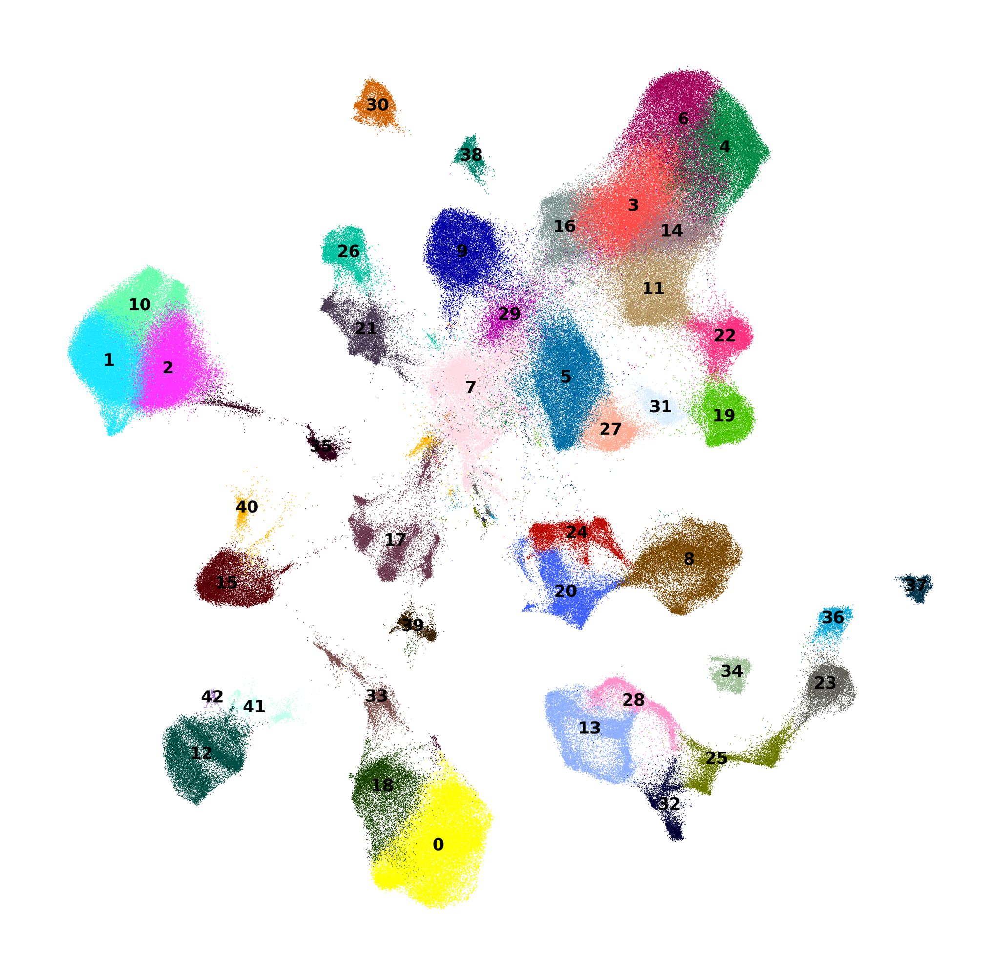

In [22]:
# plot clusters:
sc.settings.set_figure_params(dpi=300, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap( adata,color=["leiden"],frameon=False, legend_fontsize=5, legend_loc='on data', title='', save='_leiden.pdf')


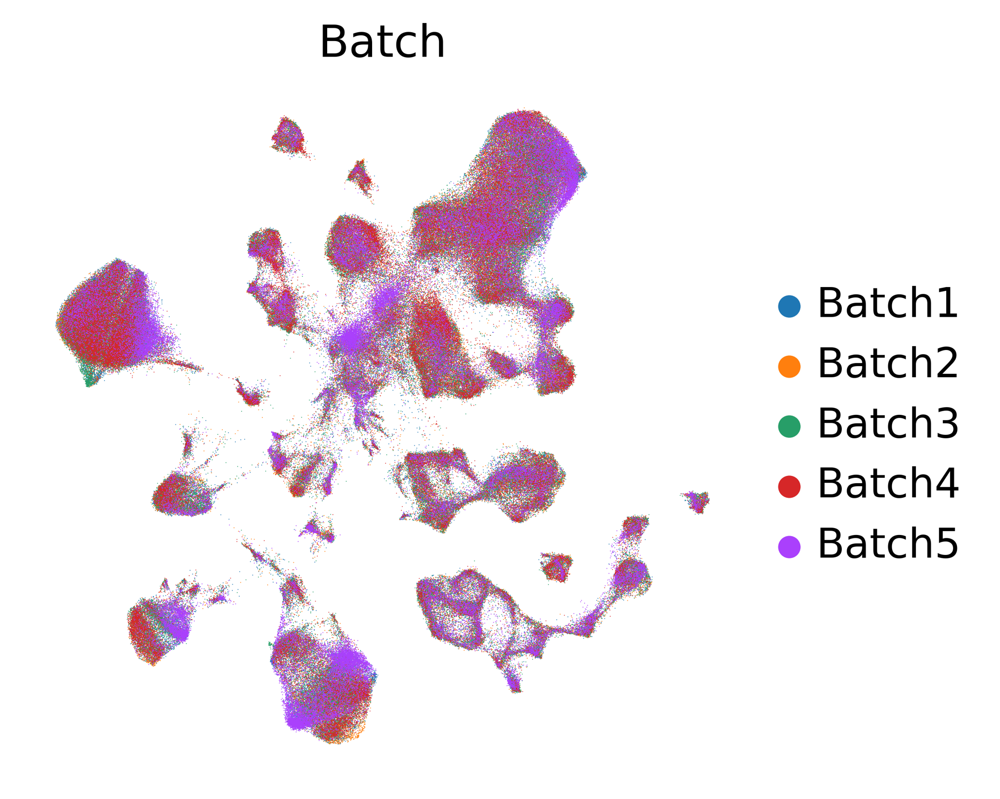

In [23]:
# plot categoriacal variables:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap( adata,color=["Batch"],frameon=False)


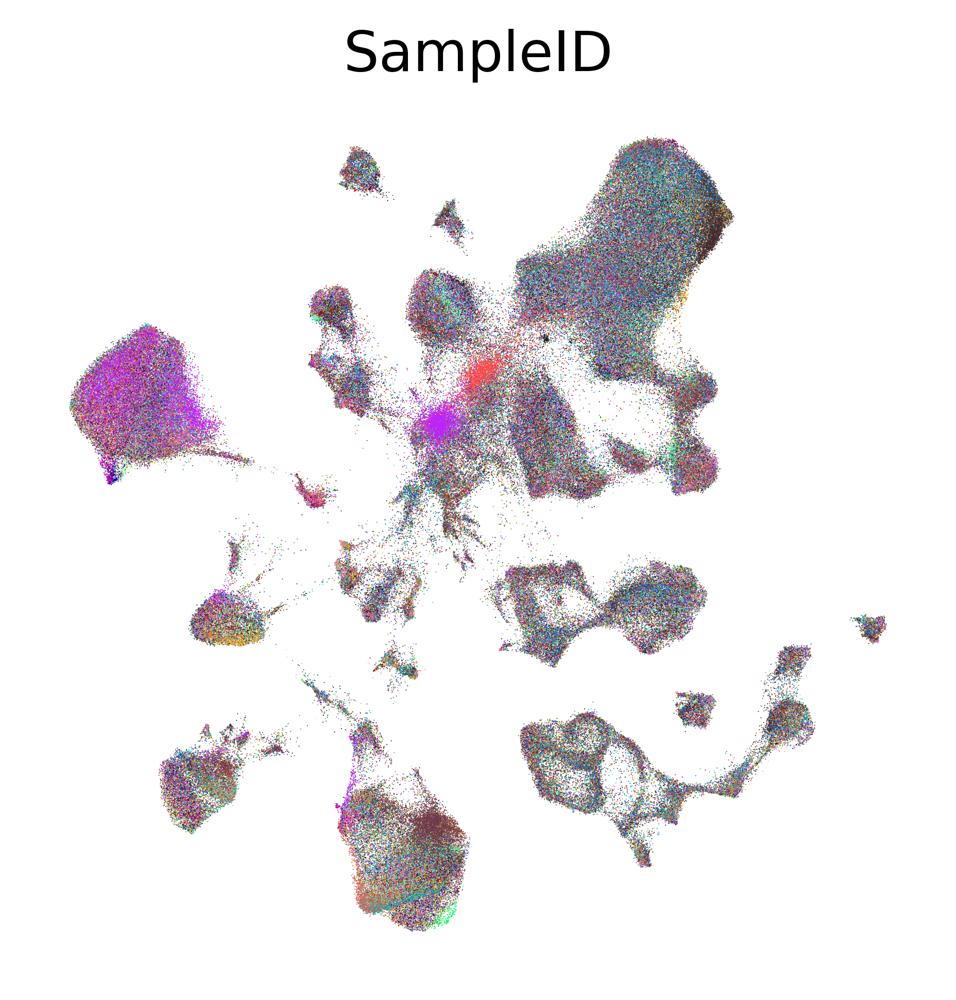

In [26]:
# plot categoriacal variables:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap( adata,color=["SampleID"],frameon=False, legend_loc=None)


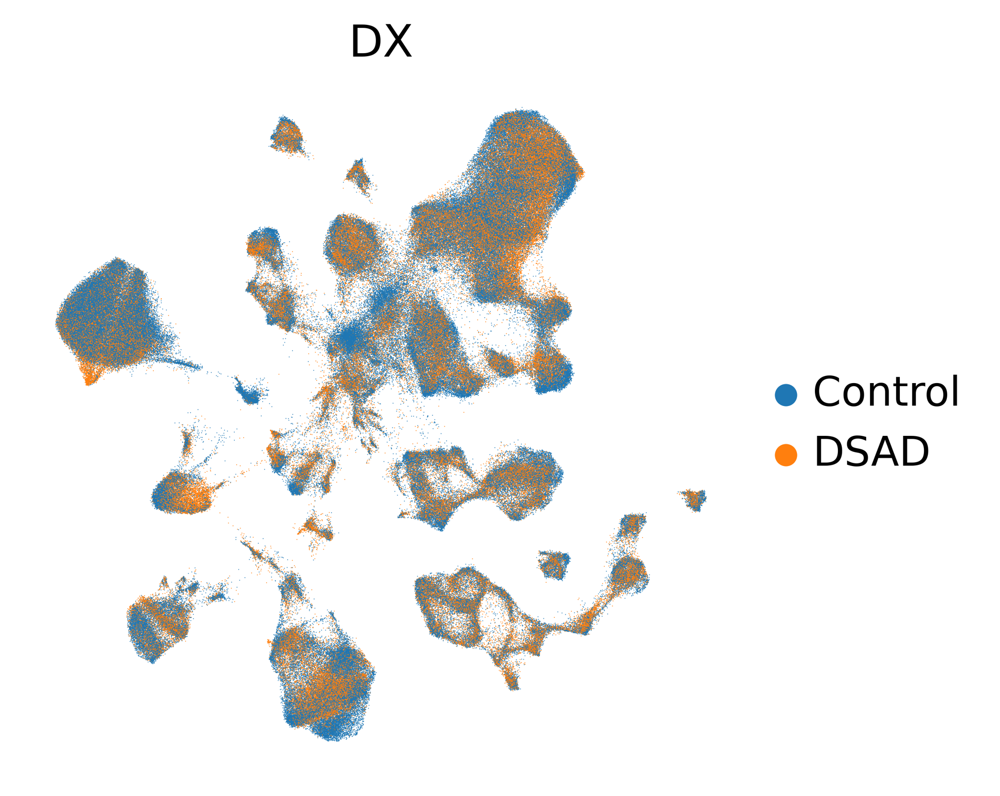

In [27]:
# plot categoriacal variables:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap( adata,color=["DX"],frameon=False)


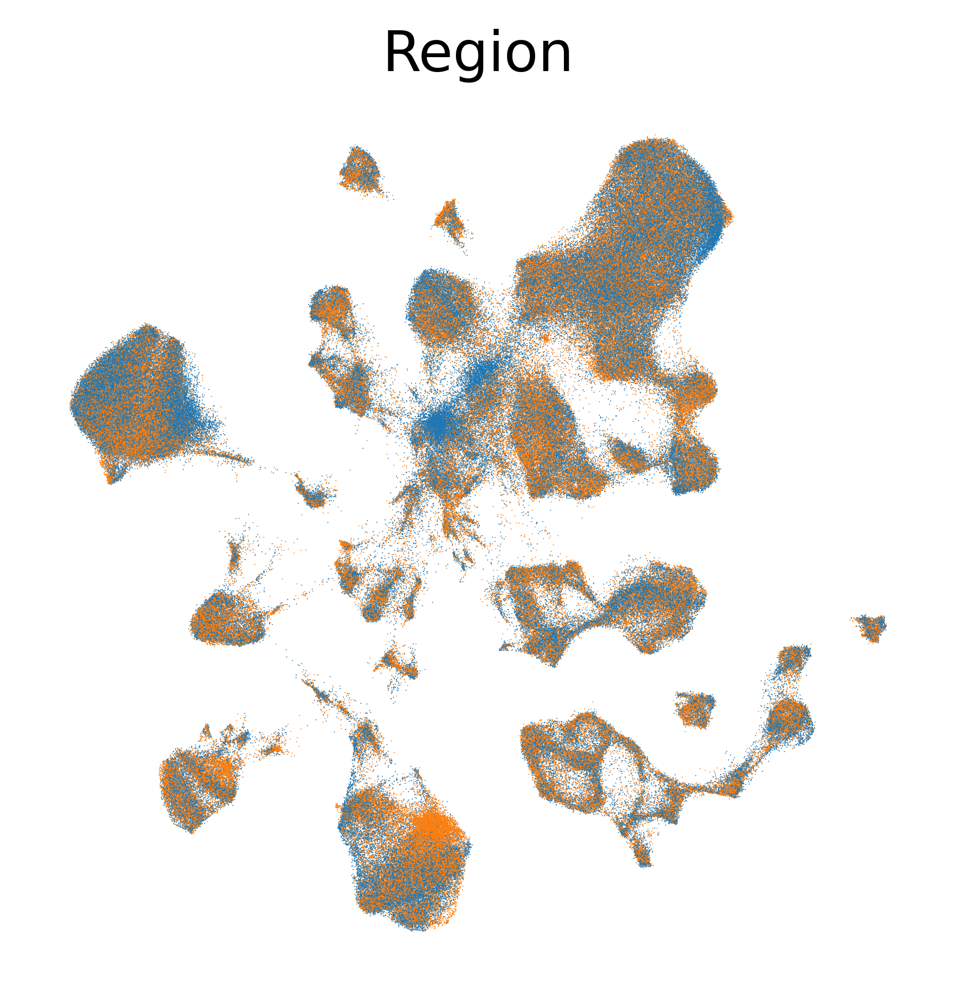

In [28]:
# plot categoriacal variables:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap( adata,color=["Region"],frameon=False, legend_loc=None)


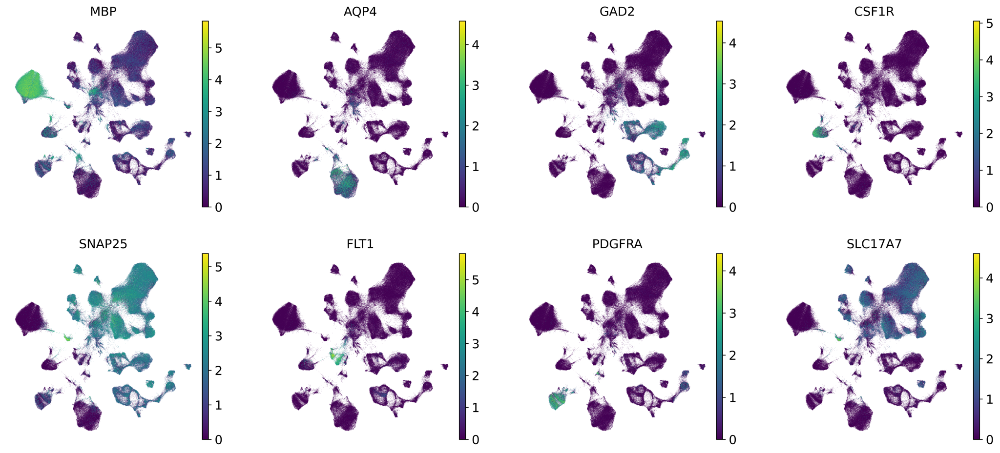

In [29]:
sc.pl.umap( adata,color=["MBP", 'AQP4', 'GAD2', 'CSF1R', 'SNAP25', 'FLT1', 'PDGFRA', 'SLC17A7'],frameon=False)


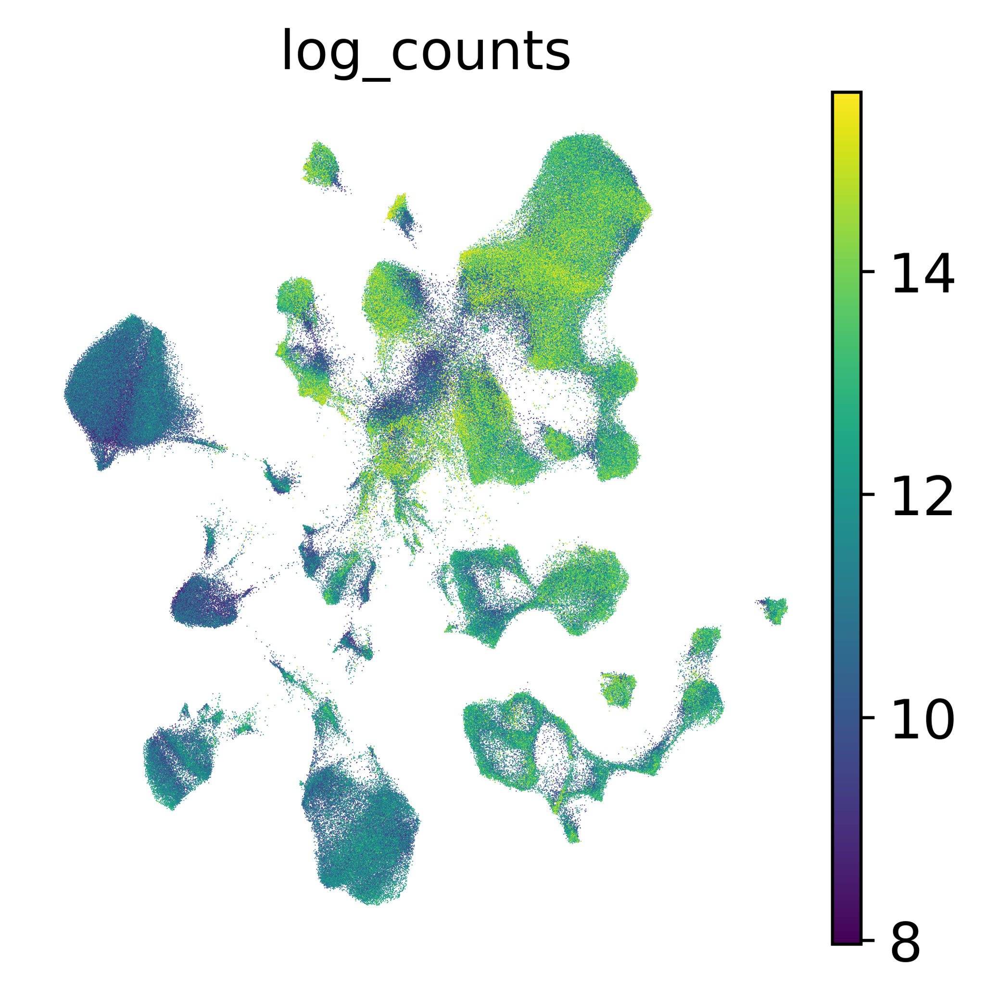

In [30]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
adata.obs['log_counts'] = np.log2(adata.obs.total_counts)
sc.pl.umap( adata,color=["log_counts"],frameon=False)


categories: 0, 1, 2, etc.
var_group_labels: Pan-neuronal, Excitatory Neuron, Inhibitory Neuron, etc.


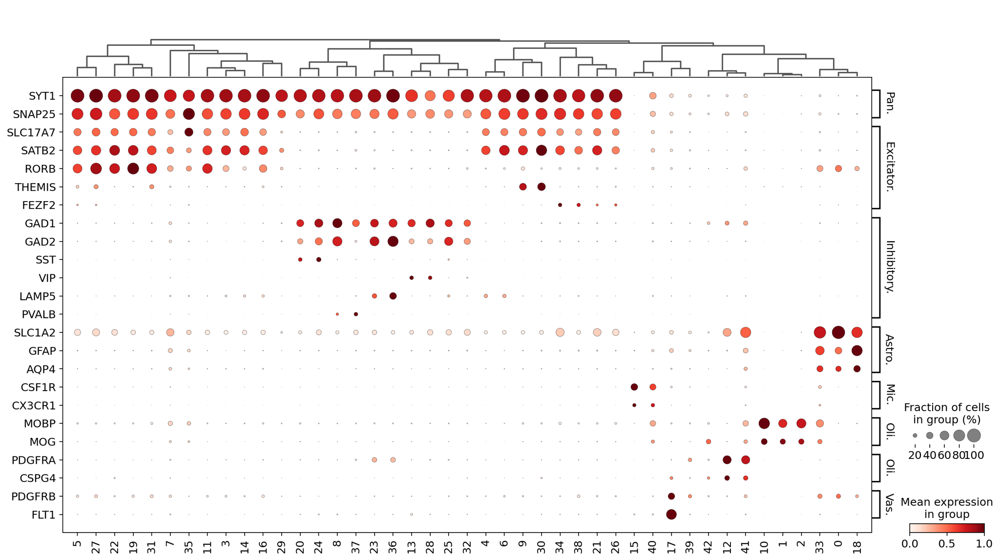

In [31]:
marker_dict = {
    'Pan-neuronal': ['SYT1', 'SNAP25'],
    'Excitatory Neuron': ['SLC17A7', 'SATB2', 'RORB', 'THEMIS', 'FEZF2'],
    'Inhibitory Neuron': ['GAD1', 'GAD2', 'SST', 'VIP', 'LAMP5', 'PVALB'],
    'Astrocyte': ['SLC1A2', 'GFAP', 'AQP4'],
    'Microglia': ['CSF1R', 'CX3CR1'],
   # 'Ependyma' : ['FOXJ1'], # not expressed
    'Oligodendrocyte': ['MOBP', 'MOG'],
    'Oligodendrocyte Progenitor': ['PDGFRA', 'CSPG4'],
    'Vasculature': ['PDGFRB', 'FLT1']
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(adata, marker_dict, 'leiden', dendrogram=True, use_raw=True, standard_scale='var', swap_axes=True, save='markers.pdf')


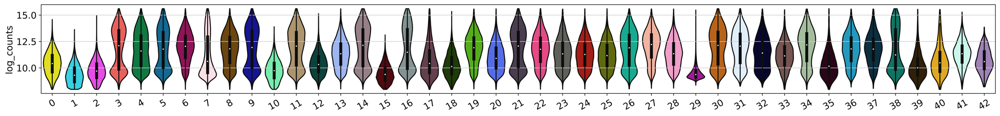

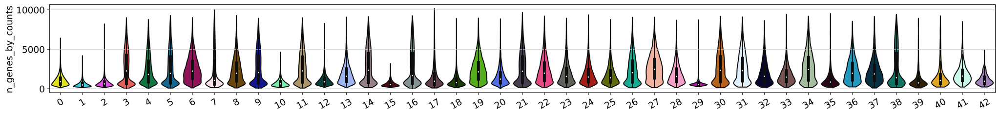

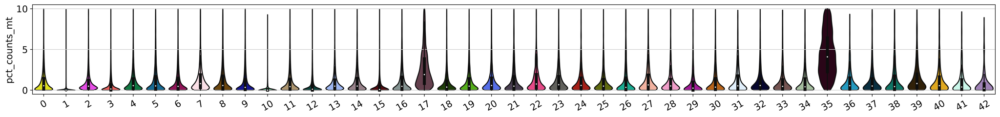

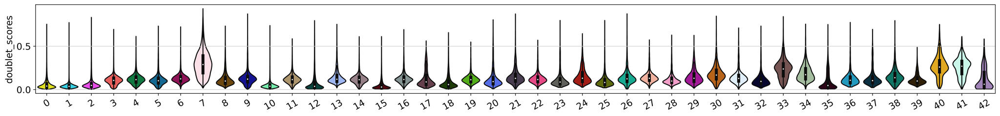

In [32]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,2.5), facecolor='white')
adata.obs['log_counts'] = np.log2(adata.obs.total_counts)
sc.pl.violin(adata,[ 'log_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'doublet_scores'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)

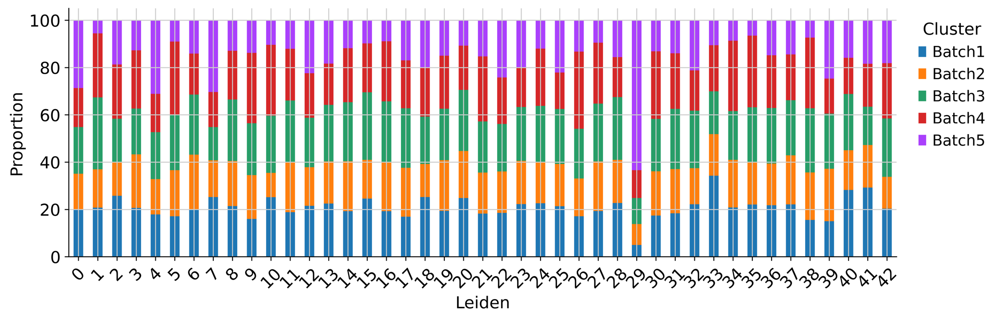

In [44]:
sc.settings.set_figure_params(dpi=300, figsize=(12,4), facecolor='white')
props = get_cluster_proportions(adata, cluster_key='Batch', sample_key='leiden')
plot_cluster_proportions(props, xlabel_rotation=45)

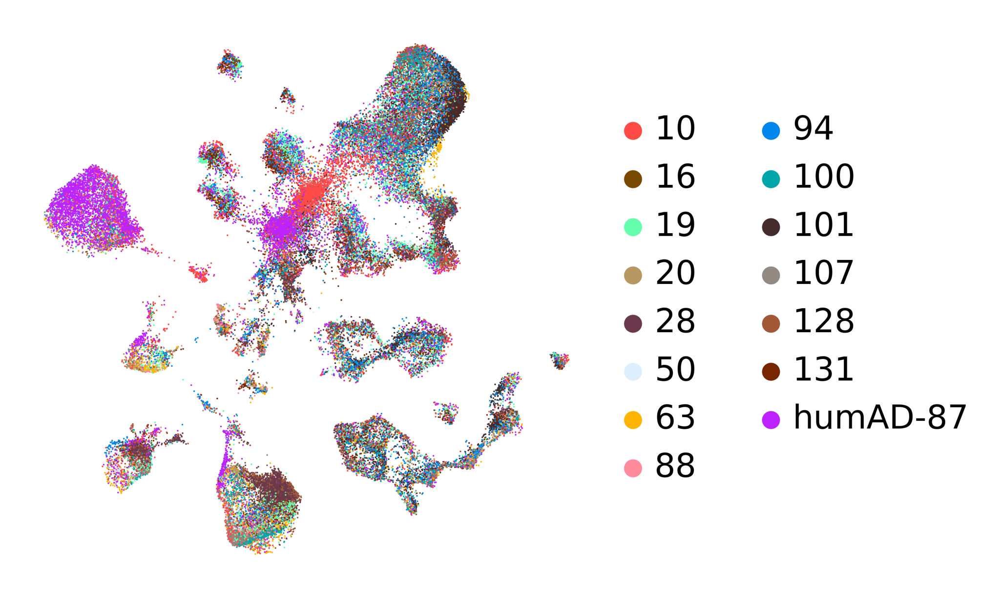

In [33]:
# plot clusters:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap( adata[adata.obs.Batch == 'Batch5'],color=["SampleID"],frameon=False, title='')


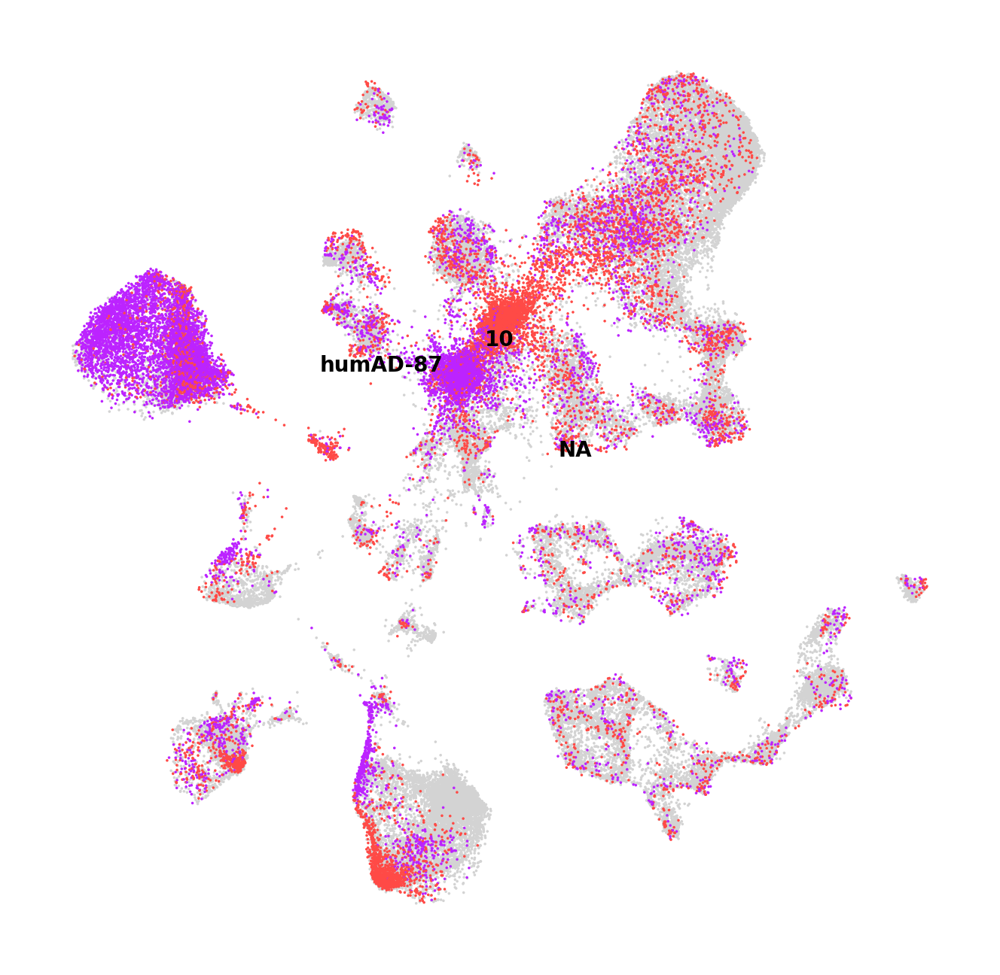

In [34]:
sc.settings.set_figure_params(dpi=200, figsize=(4,4), facecolor='white')
sc.pl.umap( adata[adata.obs.Batch == 'Batch5'],color=["SampleID"], groups=["humAD-87", "10"], frameon=False, legend_fontsize=5, legend_loc='on data', title='')


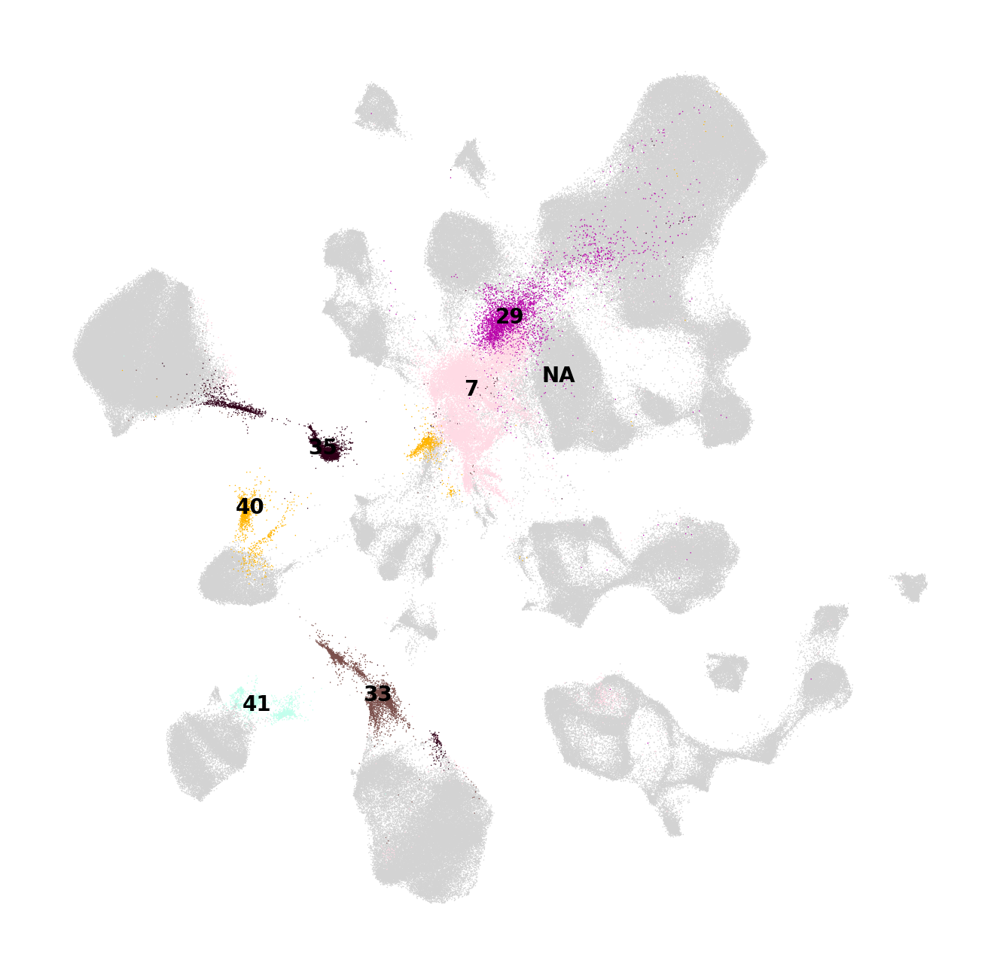

In [38]:
# clusters to remove based on low qc / conflicting markers
sc.settings.set_figure_params(dpi=200, figsize=(4,4), facecolor='white')
sc.pl.umap( adata,color=["leiden"], groups=["7", '35', '33', '29', '40', '41'], frameon=False, legend_fontsize=5, legend_loc='on data', title='')


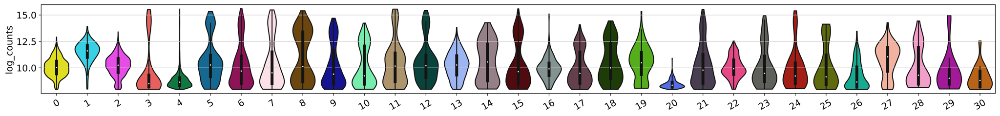

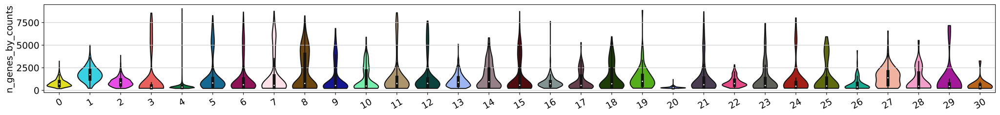

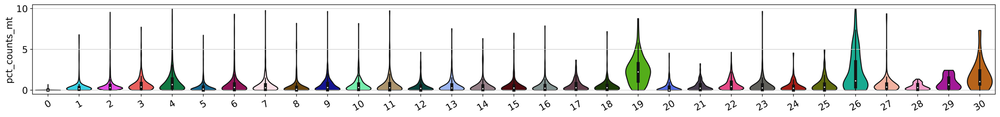

In [45]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,2.5), facecolor='white')
adata.obs['log_counts'] = np.log2(adata.obs.total_counts)
sc.pl.violin(adata[(adata.obs.Batch == 'Batch5') & (adata.obs.SampleID == 'humAD-87')],[ 'log_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata[(adata.obs.Batch == 'Batch5') & (adata.obs.SampleID == 'humAD-87')],[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata[(adata.obs.Batch == 'Batch5') & (adata.obs.SampleID == 'humAD-87')],[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)


In [39]:
# save integrated adata obj
del adata.uns['_scvi']
adata.write('{}ADDS_integrated_adata_full_11-12-21.h5ad'.format(data_dir))

In [48]:
adata_subset.shape

(398146, 3500)

In [47]:
adata_subset.obs.SampleID.value_counts()

humAD-87    10508
134          8090
28           7848
10           7381
56           7191
            ...  
88           1838
73           1770
119          1725
27           1613
15           1124
Name: SampleID, Length: 96, dtype: int64

## Re-load scvi model:

In [43]:
# # re-load the model:
# adata_full = sc.read_h5ad('{}ADDS_integrated_adata_full_11-12-21.h5ad'.format(data_dir))

# scvi.data.setup_anndata(
#     adata_full,
#     layer="counts",
#     batch_key = 'Batch',
#     categorical_covariate_keys=['SampleID', 'DX', 'Region'],
#     continuous_covariate_keys=['pct_counts_mt', 'total_counts', 'Age']
# )
# model = scvi.model.SCVI.load("trained_model_11-12-21/", adata_full)


INFO     Using batches from adata.obs["Batch"]                                               
INFO     No label_key inputted, assuming all cells have same label                           
INFO     Using data from adata.layers["counts"]                                              
INFO     Computing library size prior per batch                                              
INFO     Successfully registered anndata object containing 333986 cells, 30650 vars, 4       
         batches, 1 labels, and 0 proteins. Also registered 3 extra categorical covariates   
         and 3 extra continuous covariates.                                                  
INFO     Please do not further modify adata until model is trained.                          
INFO     Using data from adata.layers["counts"]                                              
INFO     Computing library size prior per batch                                              
INFO     Registered keys:['X', 'batch_indices', 'local_l_mea

## Remove low-quality clusters and redo UMAP + clustering

In [14]:
adata = sc.read_h5ad('{}ADDS_integrated_adata_full_08-13-21.h5ad'.format(data_dir))

In [49]:
adata_subset = adata[~adata.obs.leiden.isin(["7", '35', '33', '29', '40', '41'])]
adata = adata_subset
adata.obs['leiden_full'] = adata.obs.leiden.to_list()


Trying to set attribute `.obs` of view, copying.


In [55]:

# add old umap to obs table
adata.obs['UMAP_full_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_full_2'] = adata.obsm['X_umap'][:,1]


In [50]:
sc.pp.neighbors(adata, use_rep="X_scVI", metric='cosine')

In [51]:
# run clustering with default settings
sc.tl.leiden(adata, resolution=1.2)
sc.tl.dendrogram(adata, groupby="leiden", use_rep="X_scVI")

In [62]:

# use scVI latent space for UMAP generation
sc.tl.umap(adata, min_dist=0.2)

# add umap to obs table
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]


/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'precicted_id_old' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype_old' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: Futur

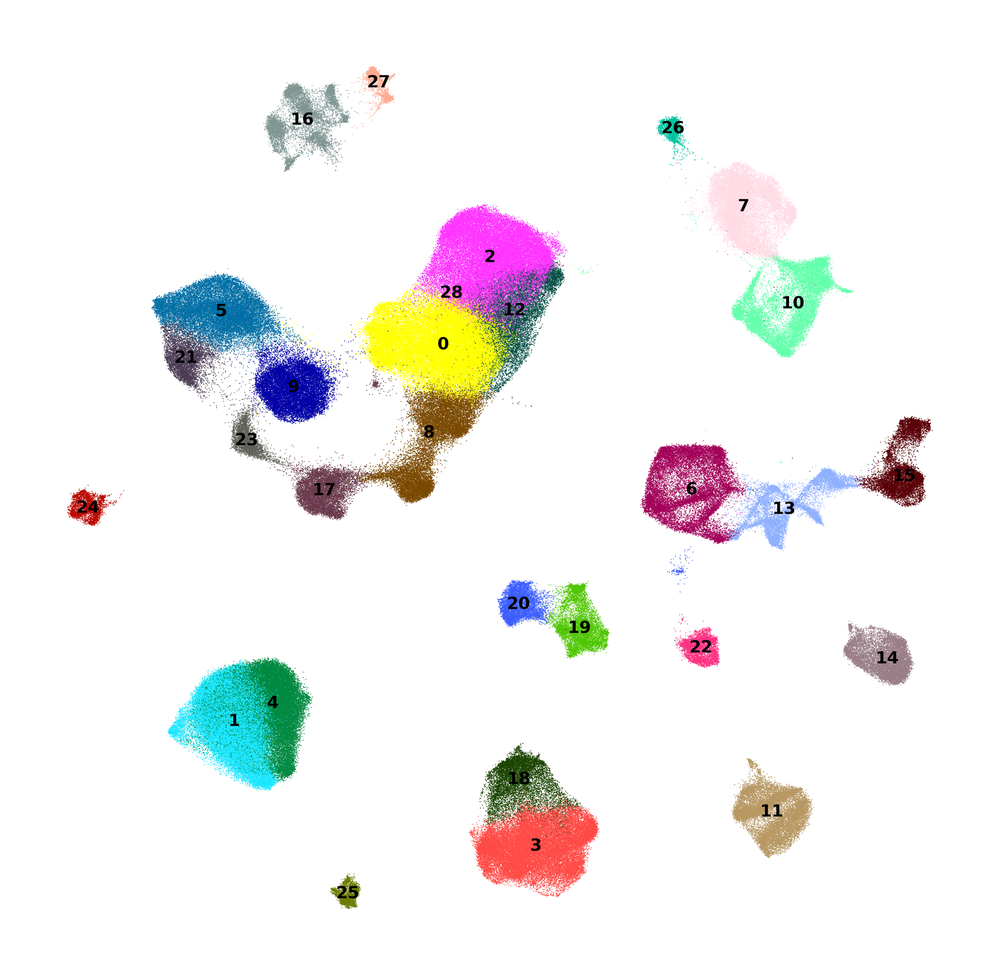

In [94]:
# plot leiden clusters
sc.settings.set_figure_params(dpi=300, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap( adata,color=["leiden"],frameon=False, legend_fontsize=5, legend_loc='on data', title='', save='_leiden.pdf')


In [66]:
sc.tl.paga(adata)

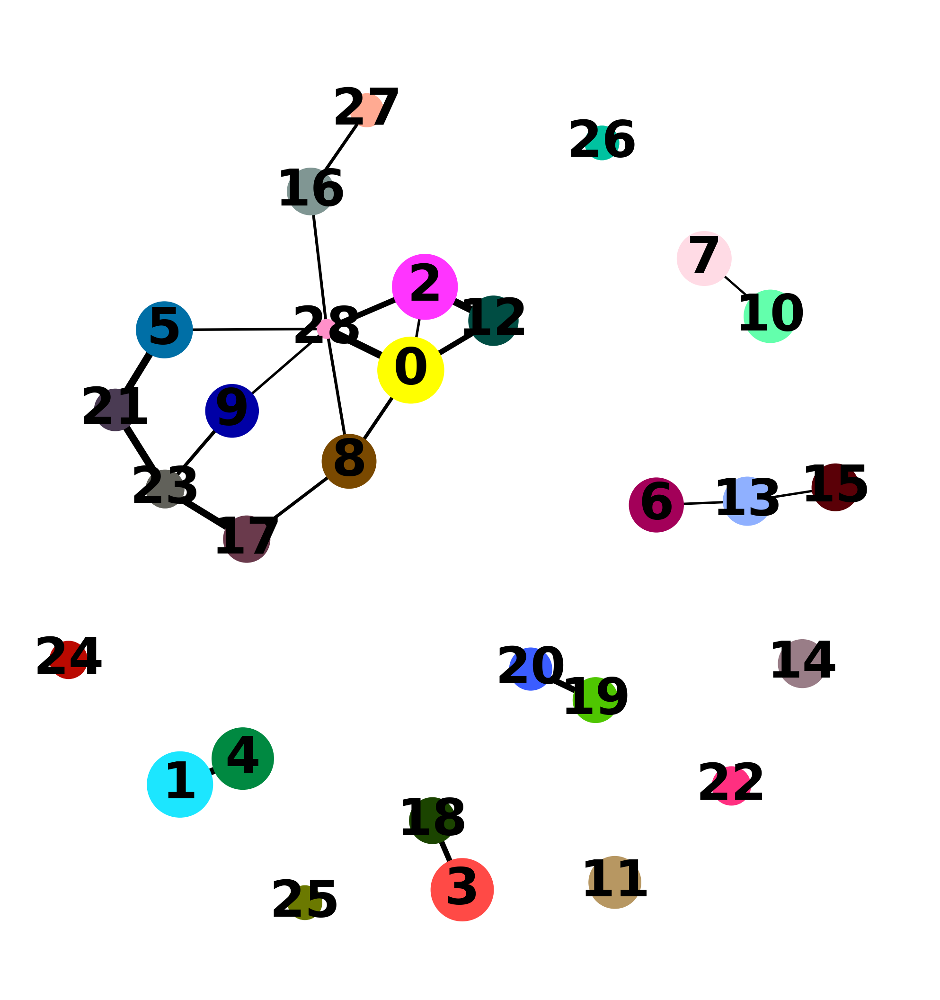

In [71]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.paga(
    adata, threshold=0.3, title='', edge_width_scale=0.25,
    frameon=False, save=True
)

In [6]:
# use scVI latent space for UMAP generation
sc.tl.umap(adata, min_dist=0.35, init_pos='paga')

# add umap to obs table
adata.obs['UMAP_1'] = adata.obsm['X_umap'][:,0]
adata.obs['UMAP_2'] = adata.obsm['X_umap'][:,1]


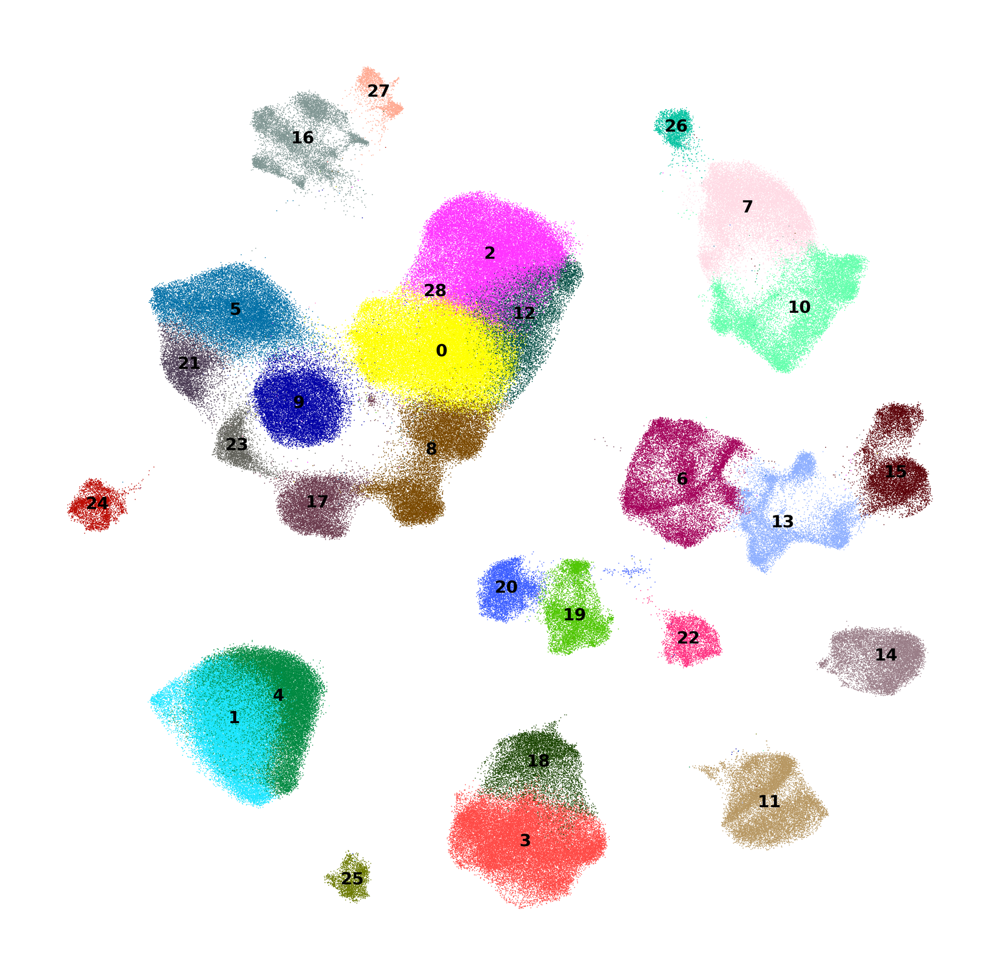

In [7]:
sc.settings.set_figure_params(dpi=300, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap( adata,color=["leiden"],frameon=False, legend_fontsize=5, legend_loc='on data', title='', save='_paga_leiden.pdf')


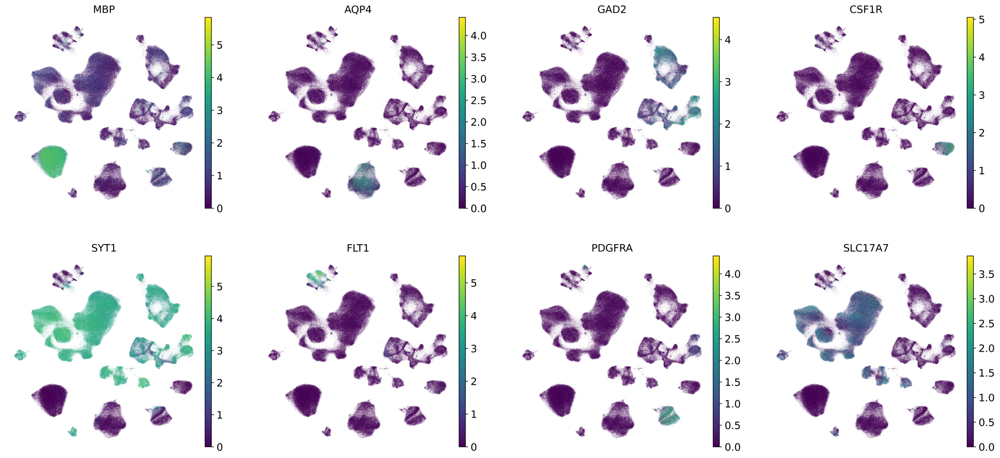

In [8]:
sc.pl.umap( adata,color=["MBP", 'AQP4', 'GAD2', 'CSF1R', 'SYT1', 'FLT1', 'PDGFRA', 'SLC17A7'],frameon=False)


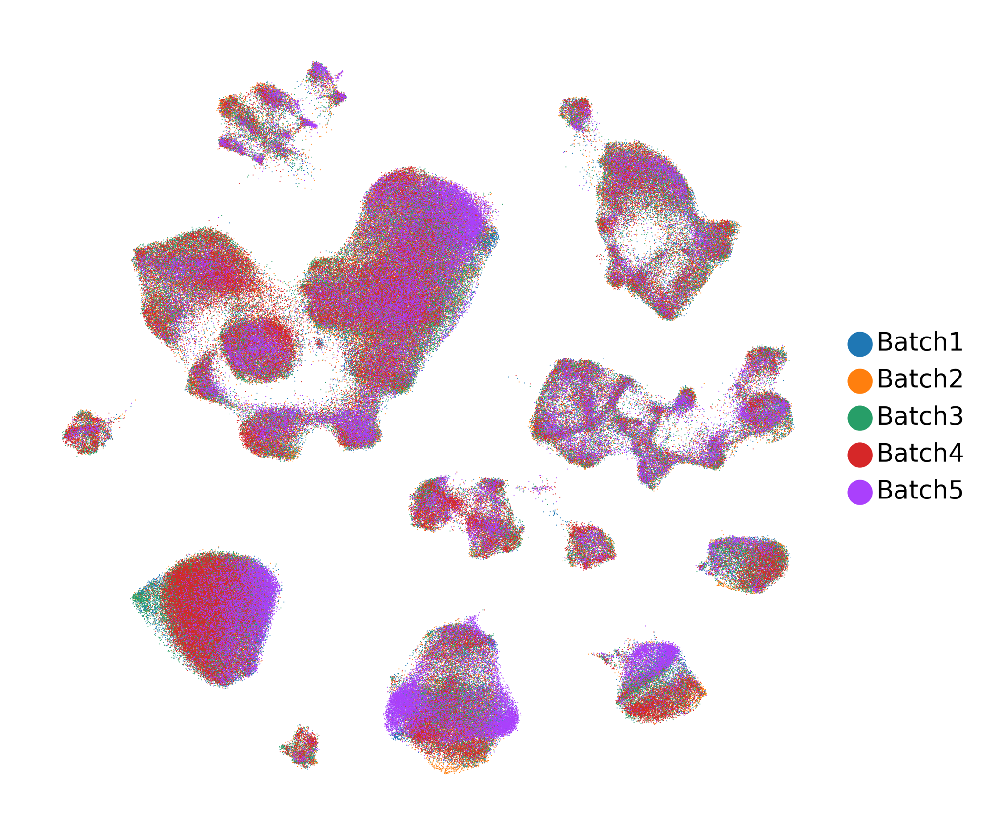

In [9]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
sc.pl.umap( adata,color=["Batch"],frameon=False, legend_fontsize=7, title='')


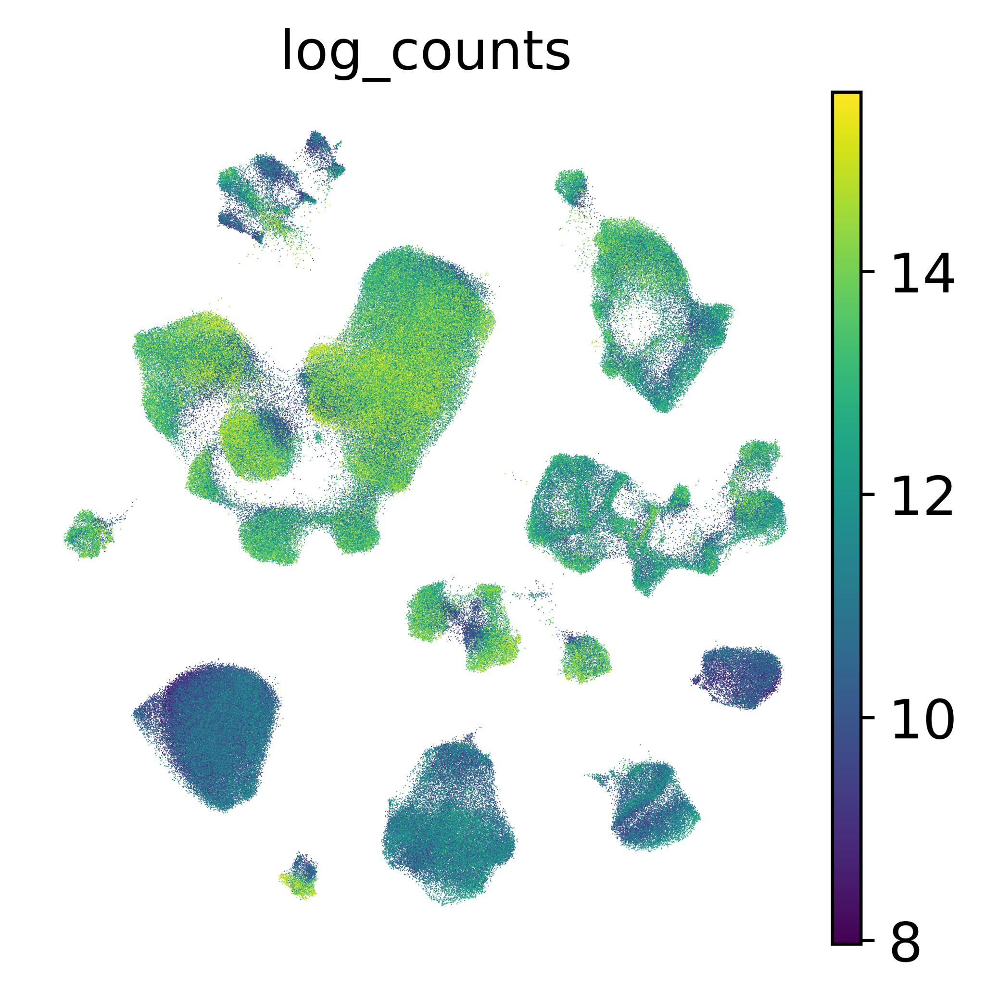

In [10]:
sc.settings.set_figure_params(dpi=300, figsize=(4,4), facecolor='white')
adata.obs['log_counts'] = np.log2(adata.obs.total_counts)
sc.pl.umap( adata,color=["log_counts"],frameon=False)


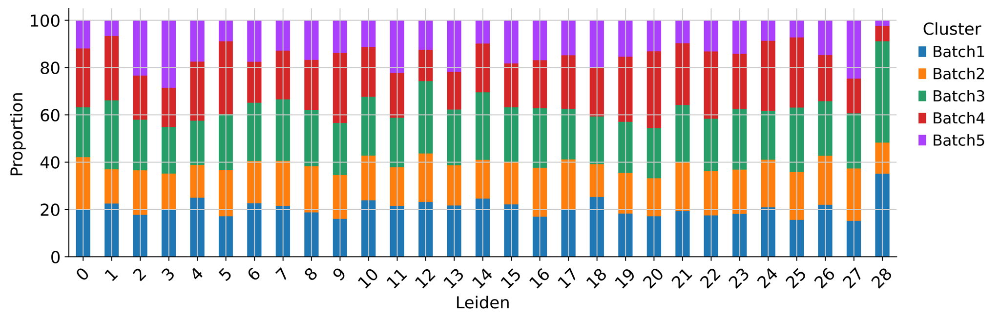

In [11]:
sc.settings.set_figure_params(dpi=300, figsize=(12,4), facecolor='white')
props = get_cluster_proportions(adata, cluster_key='Batch', sample_key='leiden')
plot_cluster_proportions(props, xlabel_rotation=45)

categories: 0, 1, 2, etc.
var_group_labels: Oligodendrocyte, Astrocyte, Microglia, etc.


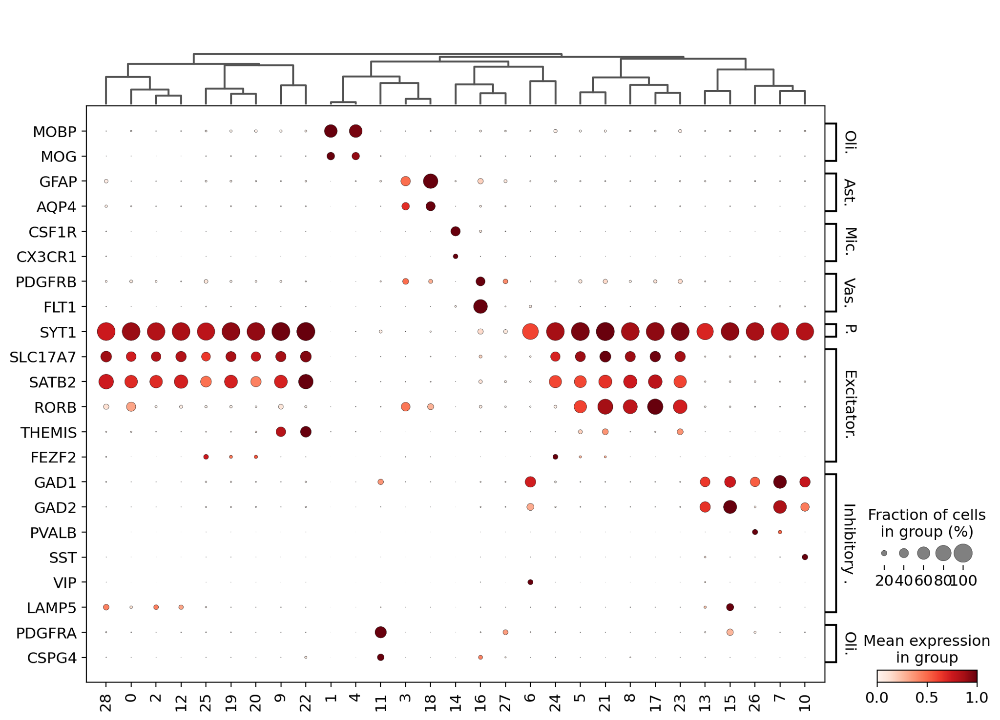

In [12]:
marker_dict = {
    'Oligodendrocyte': ['MOBP', 'MOG'],
    'Astrocyte': ['GFAP', 'AQP4'],
    'Microglia': ['CSF1R', 'CX3CR1',],
    'Vasculature': ['PDGFRB', 'FLT1'],
    'Pan-neuronal': ['SYT1'],
    'Excitatory Neuron': ['SLC17A7', 'SATB2', 'RORB', 'THEMIS', 'FEZF2'],
    'Inhibitory Neuron': ['GAD1', 'GAD2', 'PVALB', 'SST', 'VIP', 'LAMP5'],
   # 'Ependyma' : ['FOXJ1'], # not expressed
    'Oligodendrocyte Progenitor': ['PDGFRA', 'CSPG4']
}

sc.set_figure_params(dpi=100)
sc.pl.dotplot(adata, marker_dict, 'leiden', dendrogram=True, use_raw=True, standard_scale='var', swap_axes=True)


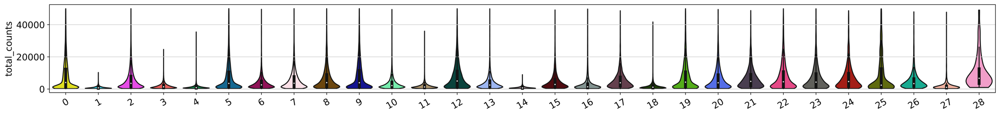

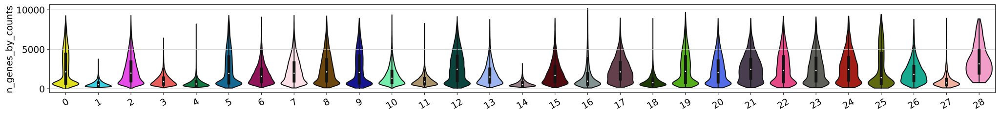

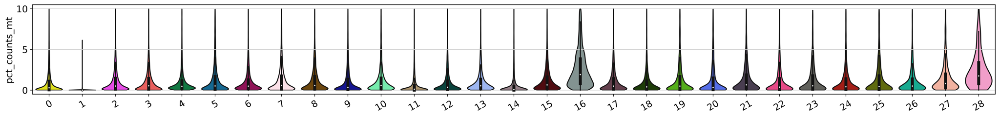

In [13]:
sc.settings.set_figure_params(dpi=500, dpi_save=1000, figsize=(20,2.5), facecolor='white')
sc.pl.violin(adata,[ 'total_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'n_genes_by_counts'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)
sc.pl.violin(adata,[ 'pct_counts_mt'], inner='box', size=0,  groupby='leiden', multi_panel=False, rotation=30)

## Annotate Clusters:

In [11]:

# load cluster anno df 
anno_df = pd.read_csv('{}ADDS_leiden_clusters.csv'.format(data_dir))

anno_df.leiden = anno_df.leiden.astype(str)
temp = adata.obs.merge(
    anno_df, how='left',
    on = 'leiden')

adata.obs['cell_type'] = temp['cell_type'].astype(str).to_list()
adata.obs['annotation'] = temp['annotation'].astype(str).to_list()
adata.obs['subtype'] = temp['subtype'].astype(str).to_list()



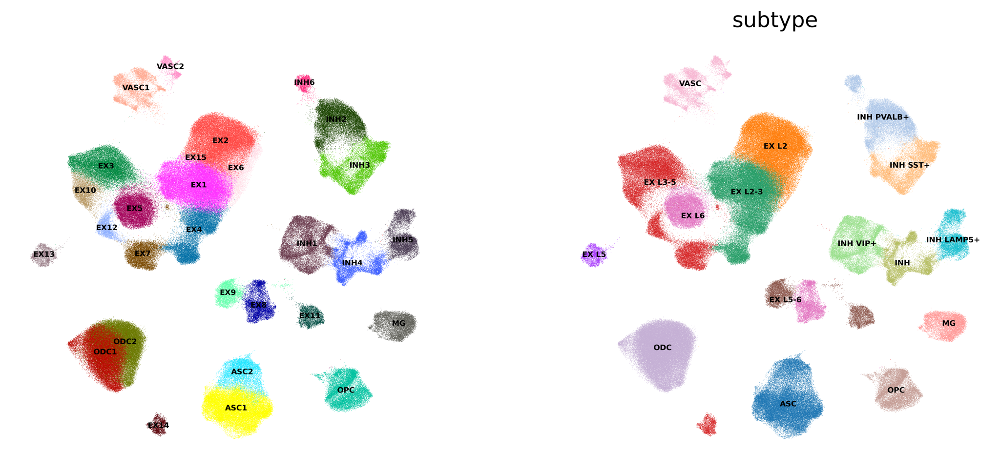

In [17]:
sc.settings.set_figure_params(dpi=300, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap( adata,color=["annotation", "subtype"],frameon=False, legend_fontsize=5, legend_loc='on data', title='', save='_paga_annotation.pdf')


In [15]:
adata.obs

,cell_barcode,species,rnd1_well,rnd2_well,rnd3_well,umi_count,umi_count_50dup,gene_count,Sublibrary,Batch,...,UMAP_1,UMAP_2,leiden,log_counts,leiden_full,UMAP_full_1,UMAP_full_2,cell_type,annotation,subtype
AGTGGTCATGGAACAA_9-0-0,AGTGGTCATGGAACAA_9,hg38,9,64,3,50168,48576.830705,8902,Sublibrary1_S1,Batch1,...,1.885365,10.731432,0,15.606463,16,9.865245,13.277141,EX,EX1,EX L2-3
ACATTGGCACGCTCGA_20-0-0,ACATTGGCACGCTCGA_20,hg38,20,20,5,50080,48491.621784,8391,Sublibrary1_S1,Batch1,...,1.302990,10.347502,0,15.603684,16,9.240021,13.650092,EX,EX1,EX L2-3
GATGAATCTCTTCACA_21-0-0,GATGAATCTCTTCACA_21,hg38,21,62,94,49718,48141.103272,8019,Sublibrary1_S1,Batch1,...,-2.406851,6.873954,23,15.593741,31,12.402791,9.055484,EX,EX12,EX L3-5
AAGAGATCAGCAGGAA_2-0-0,AAGAGATCAGCAGGAA_2,hg38,2,25,69,49713,48136.261856,8629,Sublibrary1_S1,Batch1,...,14.689492,10.692253,10,15.594033,20,9.625359,5.255204,INH,INH3,INH SST+
GACTAGTAGTACGCAA_14-0-0,GACTAGTAGTACGCAA_14,hg38,14,55,30,49494,47924.207839,8447,Sublibrary1_S1,Batch1,...,5.888000,12.249705,2,15.587132,4,13.846423,16.047785,EX,EX2,EX L2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CGACTGGAACCTCCAA_4-7-4,CGACTGGAACCTCCAA_4,hg38,4,19,40,510,452.462128,397,Sublibrary_3_S3,Batch5,...,0.201812,5.581154,17,8.965784,19,13.742800,9.317772,EX,EX7,EX L3-5
TCCGTCTACGAACTTA_29-7-4,TCCGTCTACGAACTTA_29,hg38,29,39,61,509,451.574947,422,Sublibrary_3_S3,Batch5,...,14.375152,14.129107,7,8.965784,8,12.191277,4.834936,INH,INH2,INH PVALB+
TTCACGCACGGATTGC_9-7-4,TTCACGCACGGATTGC_9,hg38,9,89,67,509,451.574947,430,Sublibrary_3_S3,Batch5,...,0.510023,5.590731,17,8.971543,19,14.368281,9.539730,EX,EX7,EX L3-5
ATTGGCTCTTCACGCA_29-7-4,ATTGGCTCTTCACGCA_29,hg38,29,67,81,508,450.687767,428,Sublibrary_3_S3,Batch5,...,11.449558,6.930483,6,8.974415,13,9.736999,0.547995,INH,INH1,INH VIP+


## Save data

In [13]:
# save the processed file:
adata.write('{}ADDS_integrated_adata_filtered_11-12-21.h5ad'.format(data_dir))

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'cell_type' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'annotation' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning:

In [17]:
# write the latent representation:
pd.DataFrame(adata.obsm['X_scVI']).to_csv('{}ADDS_integrated_Z_filtered_11-12-21.csv'.format(data_dir))

In [14]:
# write the metadata:
adata.obs.to_csv('{}ADDS_integrated_meta_filtered_11-12-21.tsv'.format(data_dir), sep='\t')

In [7]:
# get counts matrix for Seurat:
adata_unf = sc.read_h5ad('/dfs3b/swaruplab/smorabit/analysis/ADDS_2021/doublet_detection/data/ADDS_cellbender_scrublet_unfiltered.h5ad')
adata_unf = adata_unf[adata.obs.index]
X = adata_unf.X
X.shape

(398146, 29889)

In [8]:
# write the var table:
adata_unf.var.to_csv('{}ADDS_integrated_var_11-12-21.csv'.format(data_dir))

In [36]:
# write counts mat
import scipy
X = scipy.sparse.csr_matrix.transpose(X)
io.mmwrite('{}ADDS_integrated_counts_filtered_11-12-21.mtx'.format(data_dir), X)

In [47]:
# write scvi normalized mat (takes a really long time):
X = adata.layers['scvi_normalized']
X = X.transpose()
np.savetxt("{}ADDS_integrated_scvi-exp_filtered_11-12-21.csv".format(data_dir), X, delimiter=",")


In [4]:
X = adata.X 
type(X)

scipy.sparse.csr.csr_matrix

In [5]:
X.shape

(398146, 3500)

## Look at the cell-type annotations from our previous analysis:

In [5]:
seurat_meta = pd.read_csv(
    '/dfs3b/swaruplab/smorabit/analysis/ADDS_2021/data/ADDS_integrated_seurat_08-13-21_metadata.csv'
)
seurat_meta.index = seurat_meta['Unnamed: 0']
seurat_meta.index.name = None

# get just the cols we need
seurat_meta = seurat_meta[['predicted_id', 'celltype', 'subtype']]

# merge with adata
seurat_meta = adata.obs.merge(seurat_meta, how='left', left_index=True, right_index=True)

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/IPython/core/interactiveshell.py:3417: DtypeWarning: Columns (7,14,16) have mixed types.Specify dtype option on import or set low_memory=False.
  exec(code_obj, self.user_global_ns, self.user_ns)


In [6]:
# add info to obs
adata.obs['precicted_id_old'] = seurat_meta['predicted_id']
adata.obs['celltype_old'] = seurat_meta['celltype']
adata.obs['subtype_old'] = seurat_meta['subtype']

In [7]:
adata.obs.head()

,cell_barcode,species,rnd1_well,rnd2_well,rnd3_well,umi_count,umi_count_50dup,gene_count,Sublibrary,Batch,...,UMAP_1,UMAP_2,leiden,log_counts,leiden_full,UMAP_full_1,UMAP_full_2,precicted_id_old,celltype_old,subtype_old
AGTGGTCATGGAACAA_9-0-0,AGTGGTCATGGAACAA_9,hg38,9,64,3,50168,48576.830705,8902,Sublibrary1_S1,Batch1,...,1.885365,10.731432,0,15.606463,16,9.865245,13.277141,Exc L3 THEMIS ENPEP,EX,EX L2-3
ACATTGGCACGCTCGA_20-0-0,ACATTGGCACGCTCGA_20,hg38,20,20,5,50080,48491.621784,8391,Sublibrary1_S1,Batch1,...,1.302990,10.347502,0,15.603684,16,9.240021,13.650092,Exc L3 THEMIS ENPEP,EX,EX L2-3
GATGAATCTCTTCACA_21-0-0,GATGAATCTCTTCACA_21,hg38,21,62,94,49718,48141.103272,8019,Sublibrary1_S1,Batch1,...,-2.406851,6.873954,23,15.593741,31,12.402791,9.055484,Exc L5 RORB MED8,EX,EX L3-5
AAGAGATCAGCAGGAA_2-0-0,AAGAGATCAGCAGGAA_2,hg38,2,25,69,49713,48136.261856,8629,Sublibrary1_S1,Batch1,...,14.689492,10.692253,10,15.594033,20,9.625359,5.255204,NaN,NaN,NaN
GACTAGTAGTACGCAA_14-0-0,GACTAGTAGTACGCAA_14,hg38,14,55,30,49494,47924.207839,8447,Sublibrary1_S1,Batch1,...,5.888000,12.249705,2,15.587132,4,13.846423,16.047785,Exc L2 LINC00507 GLRA3,EX,EX L2


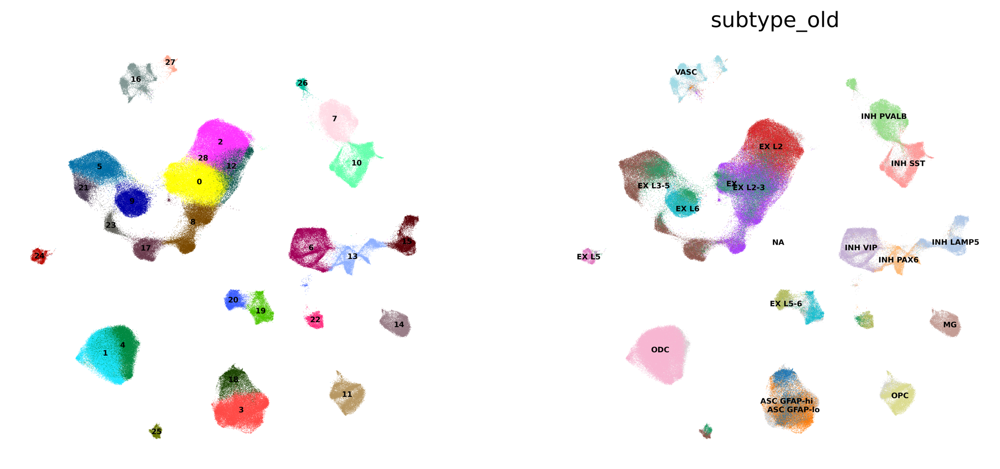

In [96]:
sc.settings.set_figure_params(dpi=300, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap( adata,color=["leiden", "subtype_old"],frameon=False, legend_fontsize=5, legend_loc='on data', title='', save='_paga_subtype_compare.pdf')


/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'precicted_id_old' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Removing unused categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'celltype_old' as categorical
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/anndata/_core/anndata.py:1220: Futur

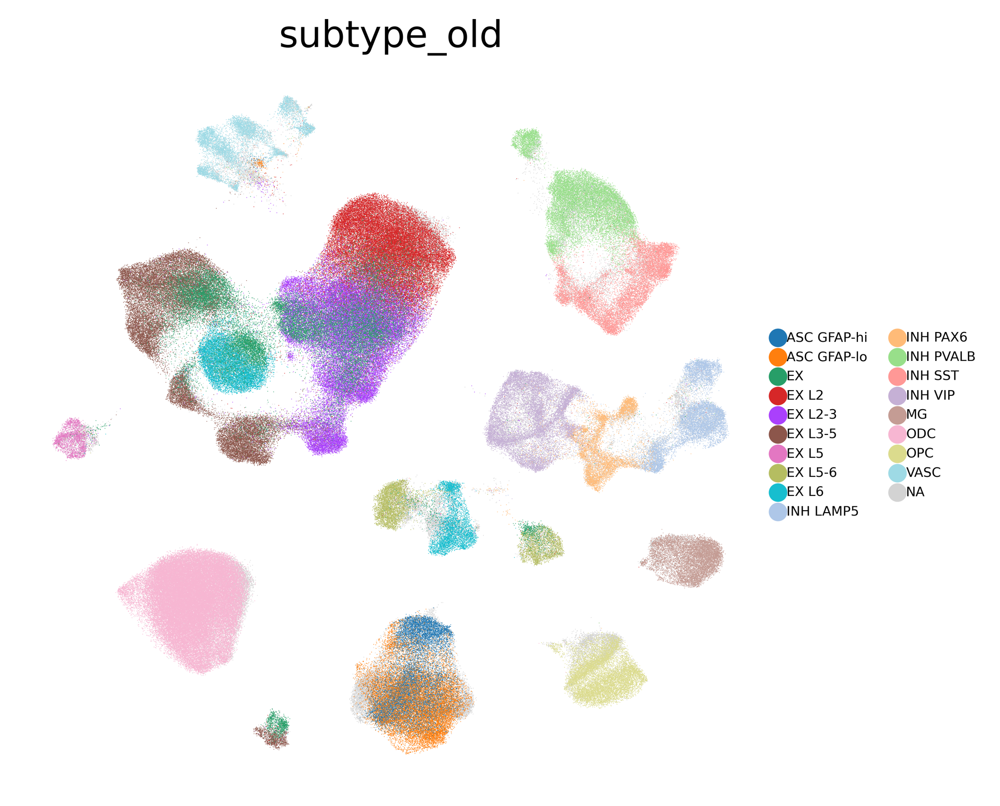

In [8]:
sc.settings.set_figure_params(dpi=300, dpi_save=1000, figsize=(5,5), facecolor='white')
sc.pl.umap( adata,color=["subtype_old"],frameon=False, legend_fontsize=5)


## Cluster marker gene analysis

In [ ]:
# re-load model (TODO)

In [38]:
# differential expression
de_df = model.differential_expression(
    groupby='leiden'
)

#de_df.to_csv('scvi/data/scvi_leiden_DEGs.csv')

NameError: name 'model' is not defined

In [66]:
de_df.columns

Index(['proba_de', 'proba_not_de', 'bayes_factor', 'scale1', 'scale2',
       'pseudocounts', 'delta', 'lfc_mean', 'lfc_median', 'lfc_std', 'lfc_min',
       'lfc_max', 'raw_mean1', 'raw_mean2', 'non_zeros_proportion1',
       'non_zeros_proportion2', 'raw_normalized_mean1', 'raw_normalized_mean2',
       'is_de_fdr_0.05', 'comparison', 'group1', 'group2', 'lnbf'],
      dtype='object')

In [65]:
de_df = de_df.assign(lnbf = lambda x: np.log(x['bayes_factor']))

de_df[de_df.lnbf >= 1.1].comparison.value_counts()

/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/dfs3b/swaruplab/smorabit/bin/software/miniconda3/envs/scvi-env/lib/python3.7/site-packages/pandas/core/arraylike.py:364: RuntimeWarning: invalid value encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


0 vs Rest     10527
12 vs Rest     7988
23 vs Rest     7155
37 vs Rest     5829
27 vs Rest     5302
3 vs Rest      4864
17 vs Rest     4836
6 vs Rest      4358
35 vs Rest     4062
19 vs Rest     3282
10 vs Rest     3080
24 vs Rest     2158
34 vs Rest     1220
8 vs Rest       814
33 vs Rest      704
26 vs Rest      702
16 vs Rest      698
31 vs Rest      692
7 vs Rest       673
15 vs Rest      591
28 vs Rest      523
9 vs Rest       519
21 vs Rest      421
20 vs Rest      374
22 vs Rest      314
13 vs Rest      258
29 vs Rest      186
5 vs Rest       160
32 vs Rest      151
30 vs Rest      120
25 vs Rest       86
14 vs Rest       85
11 vs Rest       75
2 vs Rest        59
4 vs Rest        58
1 vs Rest        46
18 vs Rest       45
36 vs Rest       19
Name: comparison, dtype: int64

In [69]:
markers = {}
cats = adata.obs.leiden.cat.categories
for i, c in enumerate(cats):
    cid = "{} vs Rest".format(c)
    cell_type_df = de_df.loc[de_df.comparison == cid]

    cell_type_df = cell_type_df[cell_type_df.lfc_mean > 0]

    cell_type_df = cell_type_df[cell_type_df["bayes_factor"] > 3]
    cell_type_df = cell_type_df[cell_type_df["non_zeros_proportion1"] > 0.1]

    markers[c] = cell_type_df.index.tolist()[:3]


categories: 0, 1, 2, etc.
var_group_labels: 0, 1, 2, etc.


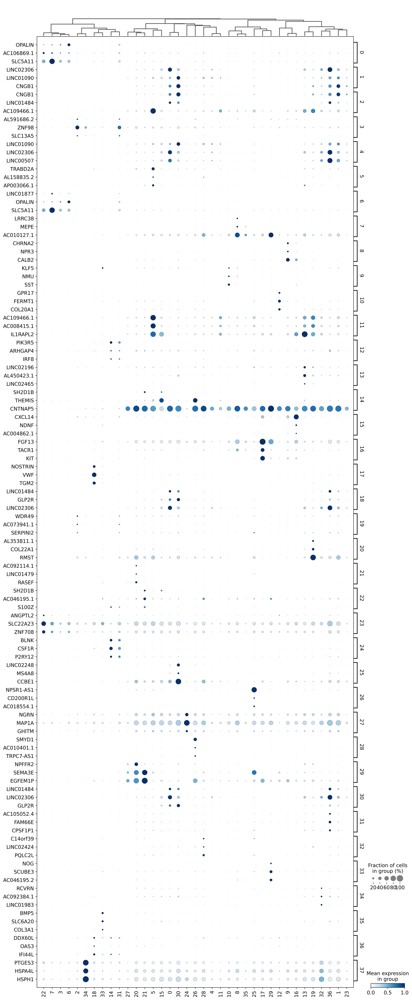

In [224]:
sc.pl.dotplot(
    adata,
    markers,
    groupby='leiden',
    dendrogram=True,
    color_map="Blues",
    swap_axes=True,
    use_raw=True,
    standard_scale="var",
)